In [1]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [2]:
import pandas as pd
import numpy as np
import seaborn as sb
import matplotlib.pyplot as plt
import plotly.express as px
import hvplot.pandas

In [3]:
credit_data = pd.read_csv('datasets/cleaned_credit.csv')
credit_data.head()

,Loan Status,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
0,Fully Paid,445412.0,Short Term,709.0,1167493.0,8 years,Home Mortgage,Home Improvements,5214.74,17.2,6.0,1.0,228190.0,416746.0,1.0,0.0
1,Fully Paid,347666.0,Long Term,721.0,806949.0,3 years,Own Home,Debt Consolidation,8741.90,12.0,9.0,0.0,256329.0,386958.0,0.0,0.0
2,Fully Paid,217646.0,Short Term,730.0,1184194.0,< 1 year,Home Mortgage,Debt Consolidation,10855.08,19.6,13.0,1.0,122170.0,272052.0,1.0,0.0
3,Fully Paid,548746.0,Short Term,678.0,2559110.0,2 years,Rent,Debt Consolidation,18660.28,22.6,4.0,0.0,437171.0,555038.0,0.0,0.0
4,Fully Paid,215952.0,Short Term,739.0,1454735.0,< 1 year,Rent,Debt Consolidation,39277.75,13.9,20.0,0.0,669560.0,1021460.0,0.0,0.0


### Numerical data

In [4]:
numerical_credit = credit_data[['Loan Status','Current Loan Amount', 'Credit Score', 'Annual Income', 'Monthly Debt', 'Years of Credit History', 'Number of Open Accounts', 'Number of Credit Problems', 'Current Credit Balance', 'Maximum Open Credit', 'Bankruptcies', 'Tax Liens']]
numerical_credit.describe()

,Current Loan Amount,Credit Score,Annual Income,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
count,49168.000000,49168.000000,4.916800e+04,49168.000000,49168.000000,49168.000000,49168.000000,4.916800e+04,4.916800e+04,49168.000000,49168.000000
mean,304587.909982,717.145766,1.336192e+06,17902.651750,17.698808,10.901135,0.168382,2.495071e+05,5.242243e+05,0.118105,0.028759
std,179337.020799,28.292476,8.160878e+05,11221.308603,6.650806,4.787154,0.485286,1.945736e+05,3.367489e+05,0.351282,0.264331
min,15422.000000,585.000000,7.662700e+04,0.000000,3.700000,1.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000
25%,171820.000000,704.000000,8.482502e+05,10193.500000,13.100000,7.000000,0.000000,1.097772e+05,2.658425e+05,0.000000,0.000000
50%,264946.000000,724.000000,1.161204e+06,15970.450000,16.600000,10.000000,0.000000,2.013240e+05,4.473480e+05,0.000000,0.000000
75%,419479.500000,739.000000,1.609395e+06,23376.840000,21.000000,13.000000,0.000000,3.401048e+05,7.181350e+05,0.000000,0.000000
max,789250.000000,751.000000,3.647544e+07,435843.280000,70.500000,56.000000,15.000000,7.350321e+06,1.564112e+06,7.000000,15.000000


#### Reclassifying numerical to categorical variables

We also noticed that the 3rd quartile of 'Number of Credit Problems', 'Bankruptcies' and 'Tax Liens' were 0, so we felt it was more meaningful to categorise them as categorical variables instead.

In [5]:
numerical_credit = numerical_credit.drop(columns=['Number of Credit Problems', 'Bankruptcies', 'Tax Liens'])

#### Assigning dummy variables

We included 'Loan Status' in order to analyse the effects of the numerical variables on it. Thereafter, we assigned a value of '0' and '1' to 'Charged Off' and 'Fully Paid' respectively as a dummy variable.

In [6]:
pd.options.mode.chained_assignment = None
numerical_credit['Loan Status'].replace('Fully Paid', '1', inplace=True)
numerical_credit['Loan Status'].replace('Charged Off', '0', inplace=True)
numerical_credit['Loan Status'] = numerical_credit['Loan Status'].astype(int)
numerical_credit.head()

,Loan Status,Current Loan Amount,Credit Score,Annual Income,Monthly Debt,Years of Credit History,Number of Open Accounts,Current Credit Balance,Maximum Open Credit
0,1,445412.0,709.0,1167493.0,5214.74,17.2,6.0,228190.0,416746.0
1,1,347666.0,721.0,806949.0,8741.90,12.0,9.0,256329.0,386958.0
2,1,217646.0,730.0,1184194.0,10855.08,19.6,13.0,122170.0,272052.0
3,1,548746.0,678.0,2559110.0,18660.28,22.6,4.0,437171.0,555038.0
4,1,215952.0,739.0,1454735.0,39277.75,13.9,20.0,669560.0,1021460.0


#### Visualising with violin plots

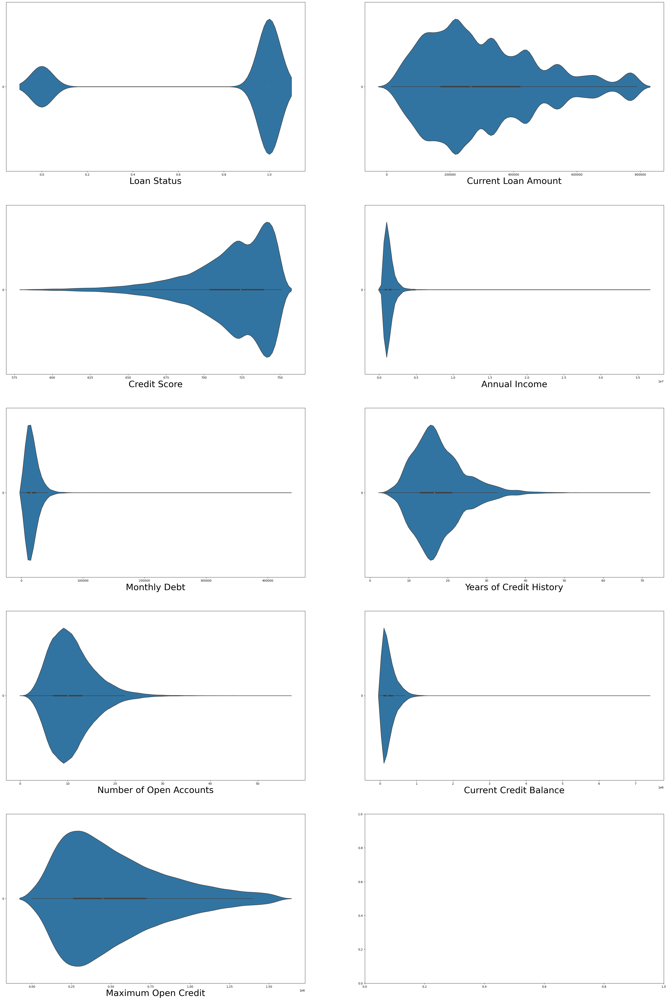

In [7]:
f, axes = plt.subplots(5,2,figsize=(40,60))
count = 0
row = 0
for var in numerical_credit:
    if count % 2 == 0:
        col = 0
    else:
        col = 1
    sb.violinplot(data = numerical_credit[var], orient = "h", ax = axes[row,col], density_norm = "width")
    ax = axes[row,col]
    ax.set_xlabel(var,fontsize=30)
    count+=1
    if count %2 == 0:
        row+=1

#### Correlation matrix and visualising

In [8]:
numerical_credit.corr()

,Loan Status,Current Loan Amount,Credit Score,Annual Income,Monthly Debt,Years of Credit History,Number of Open Accounts,Current Credit Balance,Maximum Open Credit
Loan Status,1.000000,-0.054517,0.147554,0.063838,-0.025246,0.027079,-0.022053,-0.010817,0.030812
Current Loan Amount,-0.054517,1.000000,-0.238215,0.411466,0.412191,0.151080,0.170685,0.424011,0.399677
Credit Score,0.147554,-0.238215,1.000000,-0.013820,-0.105358,0.067120,-0.045443,-0.043826,0.108553
Annual Income,0.063838,0.411466,-0.013820,1.000000,0.538610,0.191694,0.137320,0.315548,0.279213
Monthly Debt,-0.025246,0.412191,-0.105358,0.538610,1.000000,0.188240,0.393815,0.485530,0.372868
Years of Credit History,0.027079,0.151080,0.067120,0.191694,0.188240,1.000000,0.108295,0.219139,0.230957
Number of Open Accounts,-0.022053,0.170685,-0.045443,0.137320,0.393815,0.108295,1.000000,0.277267,0.418795
Current Credit Balance,-0.010817,0.424011,-0.043826,0.315548,0.485530,0.219139,0.277267,1.000000,0.722609
Maximum Open Credit,0.030812,0.399677,0.108553,0.279213,0.372868,0.230957,0.418795,0.722609,1.000000


<Axes: >

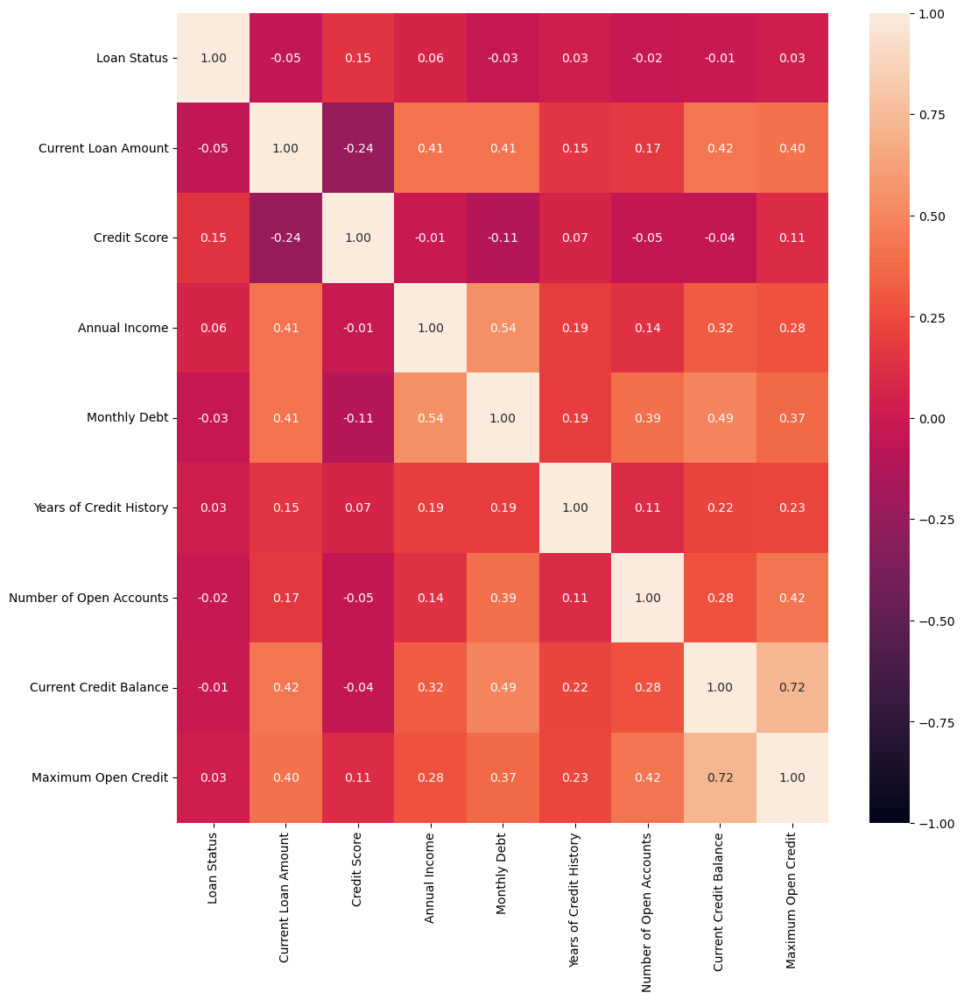

In [9]:
f = plt.figure(figsize=(12,12))
sb.heatmap(numerical_credit.corr(), vmin = -1, vmax = 1, annot = True, fmt = ".2f")

#### Visualising each numerical variable with respect to Loan Status

In [10]:
fig = px.histogram(numerical_credit, x = "Current Loan Amount", color = "Loan Status", marginal = "box")
fig.show()

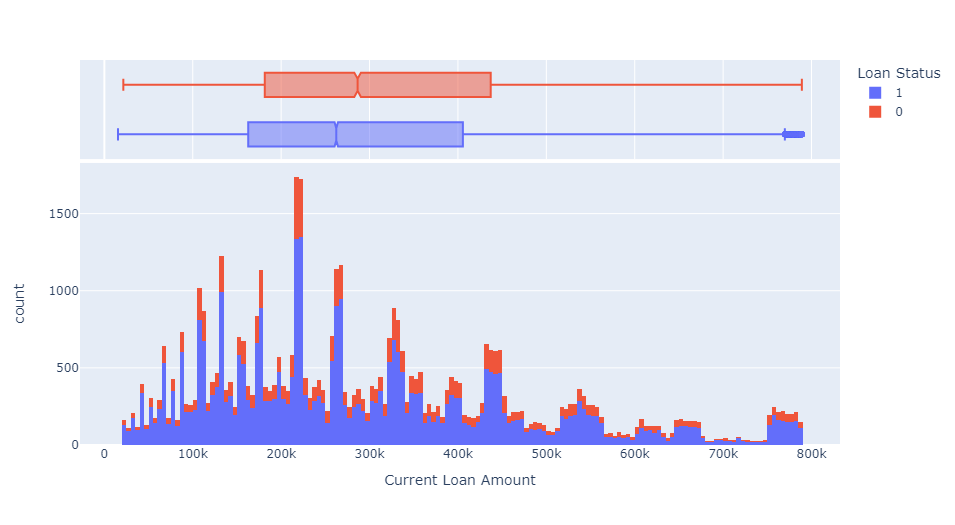

In [11]:
fig = px.histogram(numerical_credit, x = "Credit Score", color = "Loan Status", marginal = "box")
fig.show()

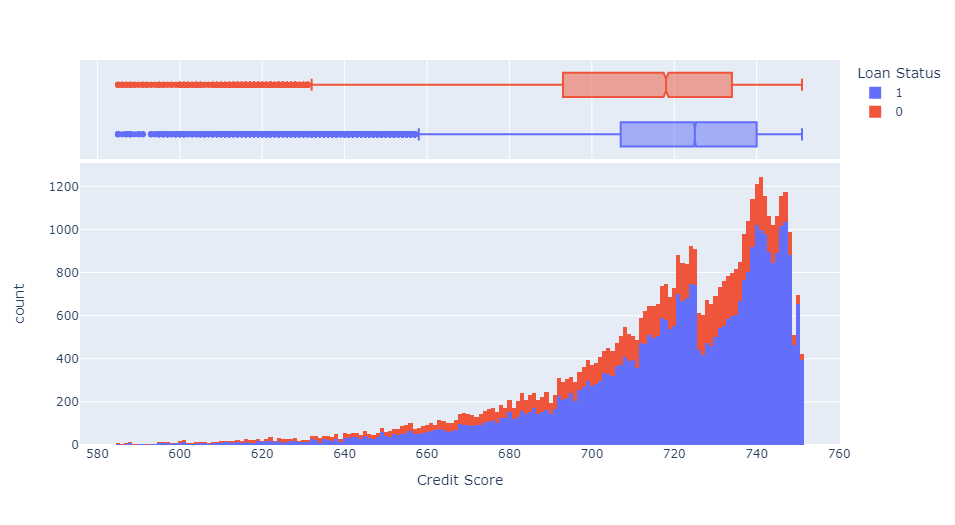

In [12]:
fig = px.histogram(numerical_credit, x = "Annual Income", color = "Loan Status", marginal = "box")
fig.show()

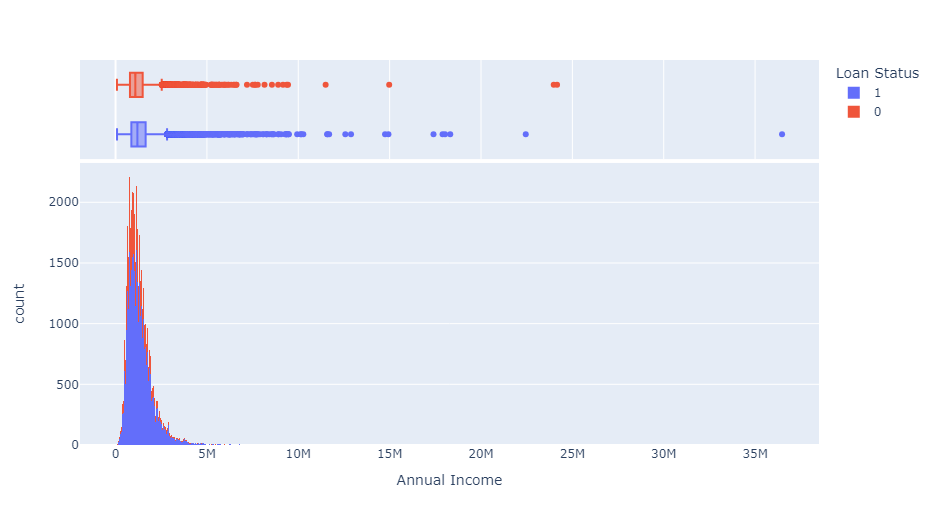

In [13]:
fig = px.histogram(numerical_credit, x = "Monthly Debt", color = "Loan Status", marginal = "box")
fig.show()

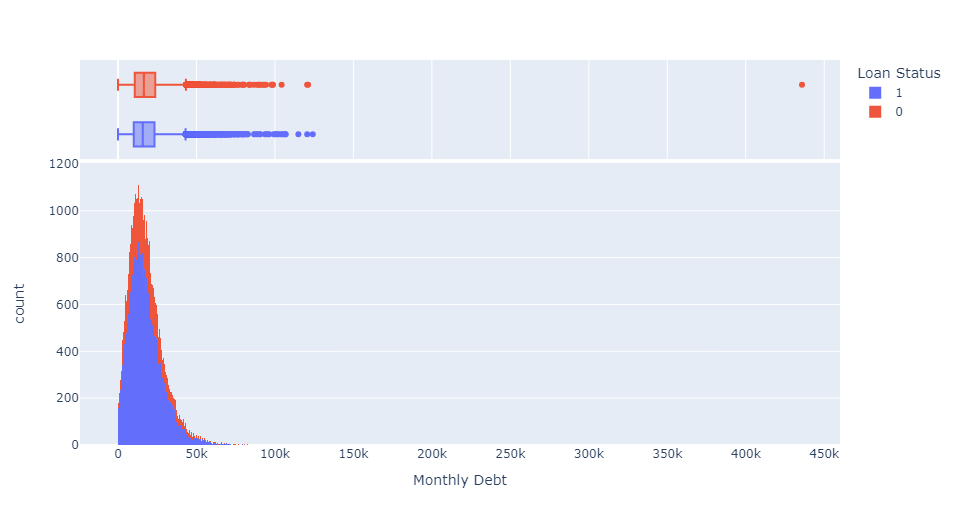

In [14]:
fig = px.histogram(numerical_credit, x = "Years of Credit History", color = "Loan Status", marginal = "box")
fig.show()

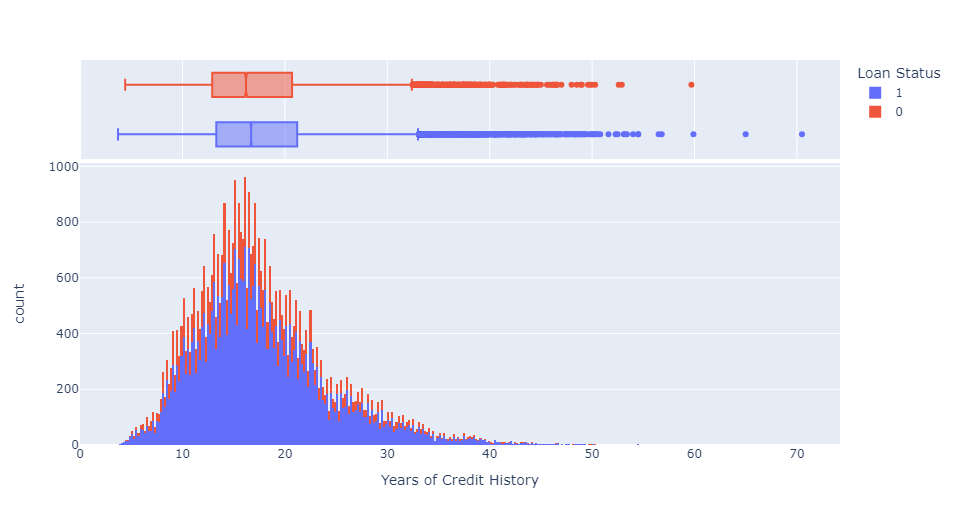

In [15]:
fig = px.histogram(numerical_credit, x = "Number of Open Accounts", color = "Loan Status", marginal = "box")
fig.show()

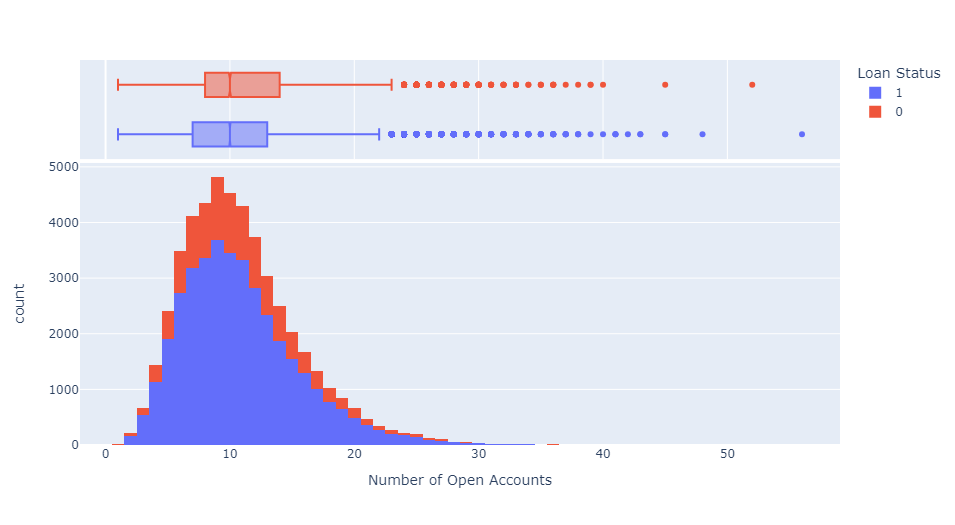

In [16]:
fig = px.histogram(numerical_credit, x = "Current Credit Balance", color = "Loan Status", marginal = "box")
fig.show()

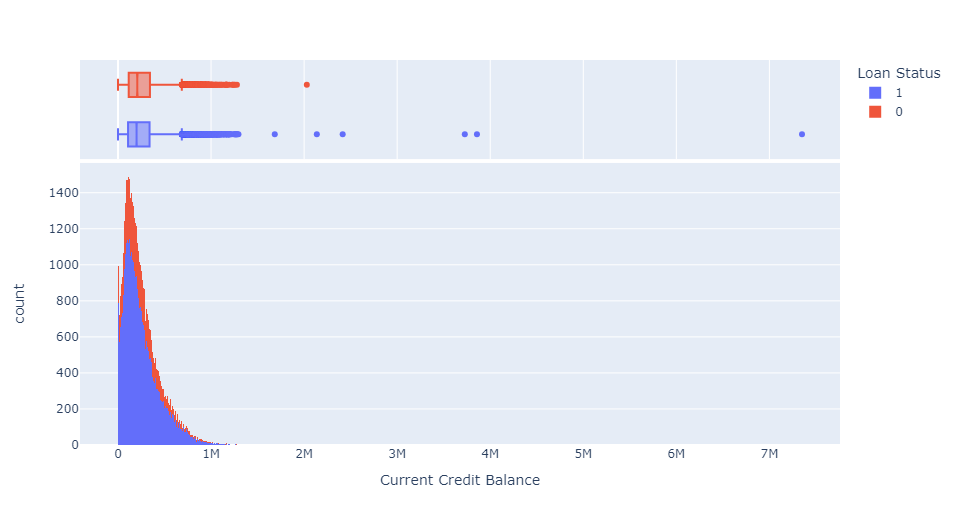

In [17]:
fig = px.histogram(numerical_credit, x = "Maximum Open Credit", color = "Loan Status", marginal = "box")
fig.show()

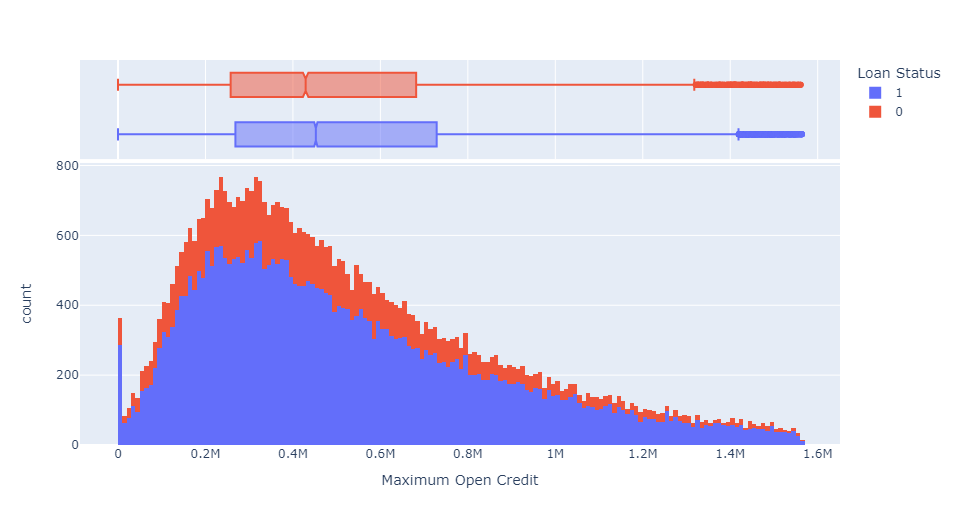

We noticed that most numerical variables are not strongly correlated with Loan Status, with the exception of Current Loan Amount, Credit Score, Annual Income, Maximum Open Credit being slightly correlated based on the deviation in boxplots.

In [18]:
numerical_credit.to_csv('datasets/numerical_credit.csv', index=False)

### Categorical Data

In [19]:
categorical_credit = credit_data[['Loan Status','Term', 'Years in current job', 'Home Ownership', 'Purpose', 'Number of Credit Problems', 'Bankruptcies', 'Tax Liens']]
categorical_credit.head()

,Loan Status,Term,Years in current job,Home Ownership,Purpose,Number of Credit Problems,Bankruptcies,Tax Liens
0,Fully Paid,Short Term,8 years,Home Mortgage,Home Improvements,1.0,1.0,0.0
1,Fully Paid,Long Term,3 years,Own Home,Debt Consolidation,0.0,0.0,0.0
2,Fully Paid,Short Term,< 1 year,Home Mortgage,Debt Consolidation,1.0,1.0,0.0
3,Fully Paid,Short Term,2 years,Rent,Debt Consolidation,0.0,0.0,0.0
4,Fully Paid,Short Term,< 1 year,Rent,Debt Consolidation,0.0,0.0,0.0


#### Reclassifying numerical to categorical variables

In [20]:
categorical_credit['Number of Credit Problems'] = pd.cut(categorical_credit['Number of Credit Problems'], 
                               bins=[0.0,1.0,999.0], 
                               labels=['0','>= 1'], right=False)
categorical_credit['Bankruptcies'] = pd.cut(categorical_credit['Bankruptcies'], 
                               bins=[0.0,1.0,999.0], 
                               labels=['0','>= 1'], right=False)
categorical_credit['Tax Liens'] = pd.cut(categorical_credit['Tax Liens'], 
                               bins=[0.0,1.0,999.0], 
                               labels=['0','>= 1'], right=False)

#### Assessing count of each variable category

In [21]:
categorical_credit['Loan Status'].value_counts()

Loan Status
Fully Paid     37752
Charged Off    11416
Name: count, dtype: int64

In [22]:
categorical_credit['Term'].value_counts()

Term
Short Term    35536
Long Term     13632
Name: count, dtype: int64

In [23]:
categorical_credit['Years in current job'].value_counts()

Years in current job
10+ years    15653
2 years       4749
3 years       4265
< 1 year      4212
5 years       3579
1 year        3319
4 years       3168
6 years       2957
7 years       2858
8 years       2403
9 years       2005
Name: count, dtype: int64

In [24]:
categorical_credit['Home Ownership'].value_counts()

Home Ownership
Home Mortgage    23189
Rent             21608
Own Home          4264
Have Mortgage      107
Name: count, dtype: int64

In [25]:
categorical_credit['Purpose'].value_counts()

Purpose
Debt Consolidation      38812
Other                    4562
Home Improvements        2730
Business Loan             773
Buy a Car                 615
Medical Bills             525
Buy House                 327
Take a Trip               278
Major Purchase            180
Small Business            145
Moving                     71
Wedding                    54
Educational Expenses       46
Vacation                   45
Renewable Energy            5
Name: count, dtype: int64

In [26]:
categorical_credit['Number of Credit Problems'].value_counts()

Number of Credit Problems
0       42282
>= 1     6886
Name: count, dtype: int64

In [27]:
categorical_credit['Bankruptcies'].value_counts()

Bankruptcies
0       43709
>= 1     5459
Name: count, dtype: int64

In [28]:
categorical_credit['Tax Liens'].value_counts()

Tax Liens
0       48255
>= 1      913
Name: count, dtype: int64

#### Visualising categorical variables with respect to loan status

In [29]:
var = categorical_credit[['Term', 'Loan Status']].copy()
plot = var.groupby(['Term', 'Loan Status'])[['Loan Status']].count().rename(columns={'Loan Status':'Count'})
graph = 100 * plot['Count'] / plot.groupby('Term')['Count'].transform('sum')
graph.hvplot.bar(stacked=False,color=["red","blue"],line_width=3,
                   line_color="black",height=350,width=700, ylabel='Percentage',title='Term against Loan Status')

:Bars   [Term,Loan Status]   (Count)

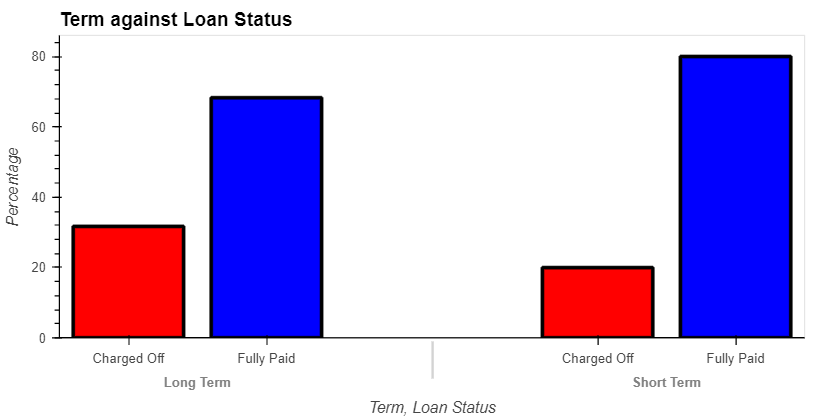

In [30]:
var = categorical_credit[['Years in current job', 'Loan Status']].copy()
plot = var.groupby(['Years in current job', 'Loan Status'])[['Loan Status']].count().rename(columns={'Loan Status':'Count'})
graph = 100 * plot['Count'] / plot.groupby('Years in current job')['Count'].transform('sum')
graph.hvplot.bar(stacked=False,color=["red","blue"],line_width=3,
                   line_color="black",height=350,width=2000, ylabel='Percentage',title='Years in current job against Loan Status')

:Bars   [Years in current job,Loan Status]   (Count)

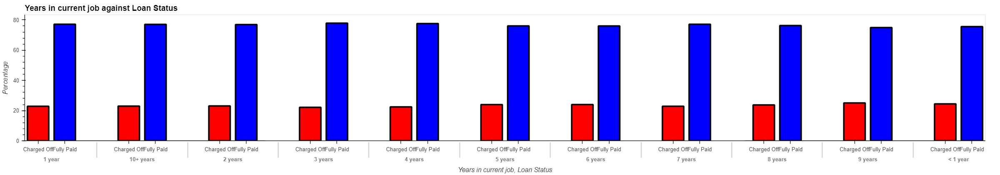

In [31]:
var = categorical_credit[['Home Ownership', 'Loan Status']].copy()
plot = var.groupby(['Home Ownership', 'Loan Status'])[['Loan Status']].count().rename(columns={'Loan Status':'Count'})
graph = 100 * plot['Count'] / plot.groupby('Home Ownership')['Count'].transform('sum')
graph.hvplot.bar(stacked=False,color=["red","blue"],line_width=3,
                   line_color="black",height=350,width=700, ylabel='Percentage',title='Home Ownership against Loan Status')

:Bars   [Home Ownership,Loan Status]   (Count)

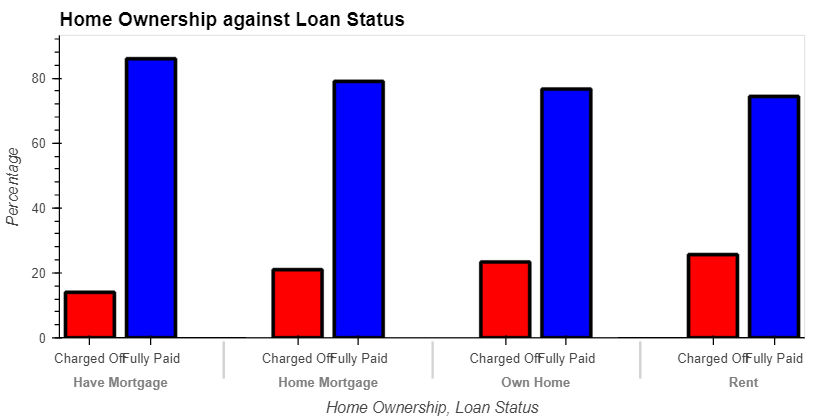

In [32]:
var = categorical_credit[['Purpose', 'Loan Status']].copy()
plot = var.groupby(['Purpose', 'Loan Status'])[['Loan Status']].count().rename(columns={'Loan Status':'Count'})
graph = 100 * plot['Count'] / plot.groupby('Purpose')['Count'].transform('sum')
graph.hvplot.bar(stacked=False,color=["red","blue"],line_width=3,
                   line_color="black",height=350,width=2500, ylabel='Percentage',title='Purpose against Loan Status')

:Bars   [Purpose,Loan Status]   (Count)

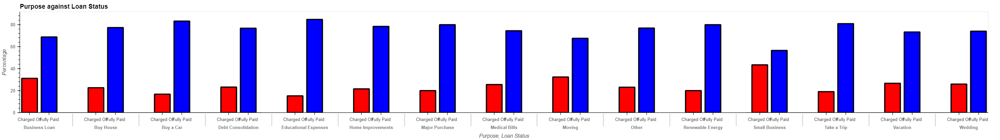

In [33]:
var = categorical_credit[['Number of Credit Problems', 'Loan Status']].copy()
plot = var.groupby(['Number of Credit Problems', 'Loan Status'])[['Loan Status']].count().rename(columns={'Loan Status':'Count'})
graph = 100 * plot['Count'] / plot.groupby('Number of Credit Problems')['Count'].transform('sum')
graph.hvplot.bar(stacked=False,color=["red","blue"],line_width=3,
                   line_color="black",height=350,width=700, ylabel='Percentage',title='Number of Credit Problems against Loan Status')

:Bars   [Number of Credit Problems,Loan Status]   (Count)

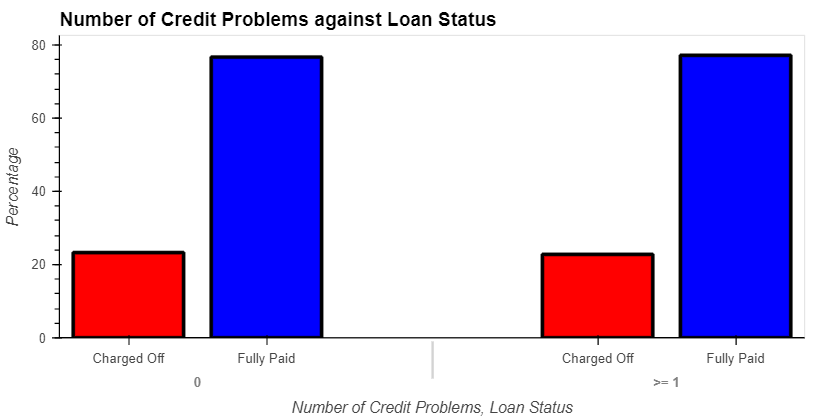

In [34]:
var = categorical_credit[['Bankruptcies', 'Loan Status']].copy()
plot = var.groupby(['Bankruptcies', 'Loan Status'])[['Loan Status']].count().rename(columns={'Loan Status':'Count'})
graph = 100 * plot['Count'] / plot.groupby('Bankruptcies')['Count'].transform('sum')
graph.hvplot.bar(stacked=False,color=["red","blue"],line_width=3,
                   line_color="black",height=350,width=700, ylabel='Percentage',title='Bankruptcies against Loan Status')

:Bars   [Bankruptcies,Loan Status]   (Count)

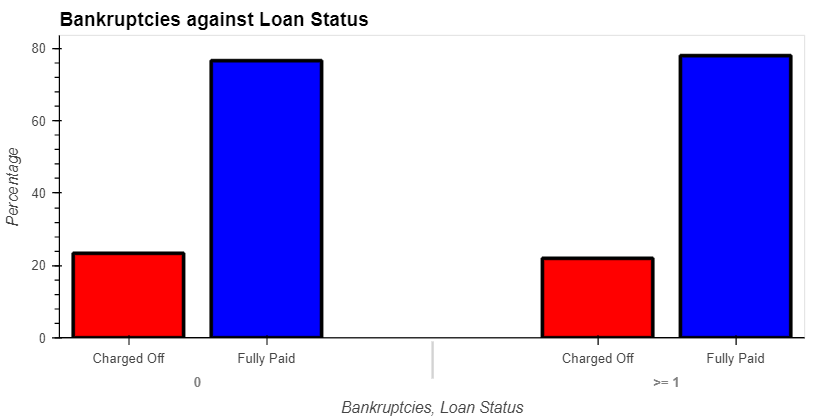

In [35]:
var = categorical_credit[['Tax Liens', 'Loan Status']].copy()
plot = var.groupby(['Tax Liens', 'Loan Status'])[['Loan Status']].count().rename(columns={'Loan Status':'Count'})
graph = 100 * plot['Count'] / plot.groupby('Tax Liens')['Count'].transform('sum')
graph.hvplot.bar(stacked=False,color=["red","blue"],line_width=3,
                   line_color="black",height=350,width=700, ylabel='Percentage',title='Tax Liens against Loan Status')

:Bars   [Tax Liens,Loan Status]   (Count)

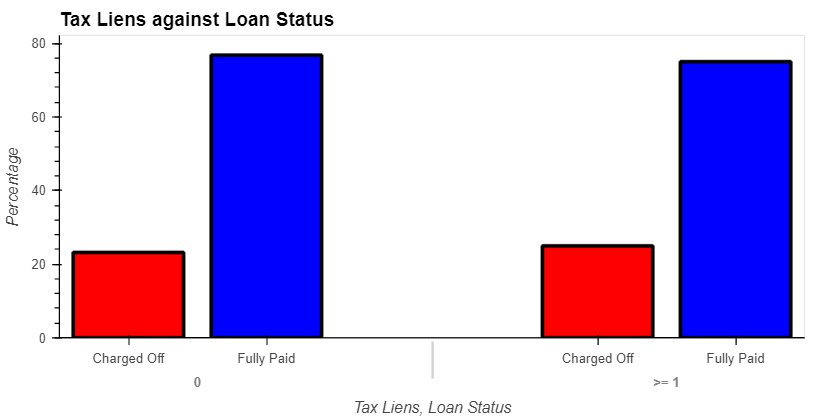

We plotted the graphs of the categorical variables against Loan Status, breaking them down into the percentages of loans that were 'Charged Off' and 'Fully Paid'. Term, Years in current job, Home Ownership and Purpose were found to have the greatest deviation between the different categories for the percentages of loans. The rest had minimal deviation so we felt that it would not be a very strong predictor for the Loan Status.

In [36]:
categorical_credit.to_csv('datasets/categorical_credit.csv', index=False)

In [37]:
categorical_credit = categorical_credit.drop(columns=['Loan Status'])
combined = pd.concat([numerical_credit, categorical_credit], axis=1)
combined.to_csv('datasets/combined.csv', index=False)